Notebook used to replicate anomaly injection method as used in Li et al., (2024). STAD: Ship trajectory anomaly detection in ocean with dynamic pattern clustering.

In [1]:
import os
import numpy as np
import pickle as pkl
import copy
import matplotlib.pyplot as plt

In [2]:
np.random.seed(1505)

# Data Loading

In [ ]:
# Using train data from publication
train_data = '../data/ais/ct_train.pkl'

In [56]:
with open(train_data, 'rb') as f:
    train = pkl.load(f)

In [57]:
LON, LAT, SOG, COG, TS, MMSI = np.arange(6)

In [58]:
# From publication source code
minmax_latlon = {'min_lat': 34.5, 'max_lat': 38.5, 'min_lng': -126, 'max_lng': -122}

x_min_lon = minmax_latlon['min_lng']
x_max_lon = minmax_latlon['max_lng']

x_min_lat = minmax_latlon['min_lat']
x_max_lat = minmax_latlon['max_lat']

x_min_sog = 0
x_max_sog = 30

x_min_cog = 0
x_max_cog = 359.9999

In [59]:
def unscale_vect(vect, x_min, x_max):
    return vect * (x_max - x_min) + x_min

In [60]:
for i in range(len(train)):
    train[i]['traj'][:, LAT] = unscale_vect(train[i]['traj'][:, LAT], x_min_lat, x_max_lat)
    train[i]['traj'][:, LON] = unscale_vect(train[i]['traj'][:, LON], x_min_lon, x_max_lon)
    train[i]['traj'][:, SOG] = unscale_vect(train[i]['traj'][:, SOG], x_min_sog, x_max_sog)
    train[i]['traj'][:, COG] = unscale_vect(train[i]['traj'][:, COG], x_min_cog, x_max_cog)

# Methods

In [61]:
def trajectory_to_grid(trajectory, boundary, lat_reso, lon_reso):

    lat, lon = trajectory[:, LAT], trajectory[:, LON]

    # Calculate grid dimensions
    lat_grid_num = int((boundary['max_lat'] - boundary['min_lat']) / lat_reso)  # number of rows
    lng_grid_num = int((boundary['max_lng'] - boundary['min_lng']) / lon_reso)  # number of columns

    # Convert to row and column indices
    row_idx = ((lat - boundary['min_lat']) / lat_reso).astype(int)
    col_idx = ((lon - boundary['min_lng']) / lon_reso).astype(int)

    # Ensure indices are within grid boundaries (elementwise operations)
    row_idx = np.clip(row_idx, 0, lat_grid_num - 1)
    col_idx = np.clip(col_idx, 0, lng_grid_num - 1)

    # Encode as single integer
    cell_ids = row_idx * lng_grid_num + col_idx

    return np.array(cell_ids)

In [62]:
def decode_cell_id_to_lat_lng(cell_ids, boundary, lat_size, lng_size, lng_grid_num):
    # Extract row and column indices
    row_idxs = cell_ids // lng_grid_num
    col_idxs = cell_ids % lng_grid_num

    # Convert to latitude and longitude (cell center)
    lat = boundary['min_lat'] + (row_idxs + 0.5) * lat_size
    lng = boundary['min_lng'] + (col_idxs + 0.5) * lng_size

    return lat, lng

In [ ]:
def plot_anomaly(original, anomaly, i, save_dir=None):

        old, new = original, anomaly

        fig, ax = plt.subplots(figsize=(12, 8))
        ax.plot(old[:, 0], old[:, 1], 'b', label='Original')
        ax.plot(new[:, 0], new[:, 1], 'r', label='Anomaly')
        # plt.title(f'Artificial Anomaly for idx {i}')
        plt.ylabel('Latitude')
        plt.xlabel('Longitude')
        plt.xlim(minmax_latlon['min_lng'], minmax_latlon['max_lng'])
        plt.ylim(minmax_latlon['min_lat'], minmax_latlon['max_lat'])
        plt.legend()
        plt.tight_layout()
        if save_dir:
            os.makedirs(save_dir, exist_ok=True)
            fp = os.path.join(save_dir, f'anomaly_{i}.pdf')
            plt.savefig(fp)
        plt.show()

In [71]:
def plot_anomalies(n_plots, train, anomalies, dpi=300, save_dir=None):
    idx = np.random.choice(np.array(list(anom_idx)), size=n_plots)

    old = train[i]['traj'][:, :2]
    new = anomalies[0][i]['traj'][:, :2]

    for i in idx:
        plot_anomaly(train, anomalies, i)

# Type 1 Shift Deviation

In [72]:
def create_type1_deviate(trajectory,
                         share_anomalous_trjs,
                         magnitude_grids,
                         share_anomalous_points,
                         lat_grid_num,
                         lon_grid_num):

        trajectory = trajectory.copy()

        # Convert trajectory to grid cell ids
        trj_cell_ids = trajectory_to_grid(trajectory, minmax_latlon, lat_reso=0.01, lon_reso=0.01)

        # Select n consecutive points in selected trajectory
        n_anomalous_points = int(share_anomalous_points * len(trj_cell_ids))
        st_anom_idx = np.random.randint(0, len(trj_cell_ids) - n_anomalous_points - 1)
        ed_anom_idx = st_anom_idx + n_anomalous_points

        # Calculate offset
        offset_x = int(trj_cell_ids[st_anom_idx] // lon_grid_num) - int(trj_cell_ids[ed_anom_idx] // lon_grid_num)
        offset_y = int(trj_cell_ids[st_anom_idx] % lat_grid_num) - int(trj_cell_ids[ed_anom_idx] % lat_grid_num)

        # Normalize the offset values
        if offset_x == 0:
            div0 = 1
        else:
            div0 = abs(offset_x)

        if offset_y == 0:
            div1 = 1
        else:
            div1 = abs(offset_y)

        # Randomize offset direction
        if np.random.random() < 0.5:
            offset_x = -offset_x / div0
            offset_y = offset_y / div1
        else:
            offset_x = offset_x / div0
            offset_y = -offset_y / div1

        # Move points by magnitude
        for i in range(st_anom_idx, ed_anom_idx):
            point = trj_cell_ids[i]
            x, y = point // lon_grid_num, point % lat_grid_num
            x += offset_x * magnitude_grids
            y += offset_y * magnitude_grids
            anom_point = int(x * lon_grid_num + y)
            trj_cell_ids[i] = anom_point


        # Output new trajectory
        new_lat, new_lon = decode_cell_id_to_lat_lng(trj_cell_ids, minmax_latlon, 0.01, 0.01, 400)
        trajectory[:, LAT] = new_lat
        trajectory[:, LON] = new_lon
        return trajectory


def inject_type1_deviate(original_trajectories,
                         share_anomalous_trjs,
                         magnitude_grids,
                         share_anomalous_points,
                         lat_grid_num,
                         lon_grid_num):

    trajectories = copy.deepcopy(original_trajectories)

    # Select n trajectories to inject anomalies
    n_anomalous_trajectories = int(len(trajectories) * share_anomalous_trjs)
    trajectories_idx = np.arange(0, len(trajectories))
    traj_anom_idx = np.random.choice(trajectories_idx, n_anomalous_trajectories, replace=False)

    for idx in traj_anom_idx:
        trajectory = trajectories[idx]['traj']

        trajectory = create_type1_deviate(trajectory)

        trajectories[idx]['traj'] = trajectory

    return trajectories, traj_anom_idx

## Generate

In [73]:
atrj = create_type1_deviate(trajectory=train[2219]['traj'],
                        share_anomalous_trjs=0.3,   # Number of trajectories that are anomalied in the input set
                        magnitude_grids=2,          # Number of grid cells the trajectory is shifted
                        share_anomalous_points=0.1, # Number of points in the trajectory that are shifted
                        lat_grid_num=400,
                        lon_grid_num=400)

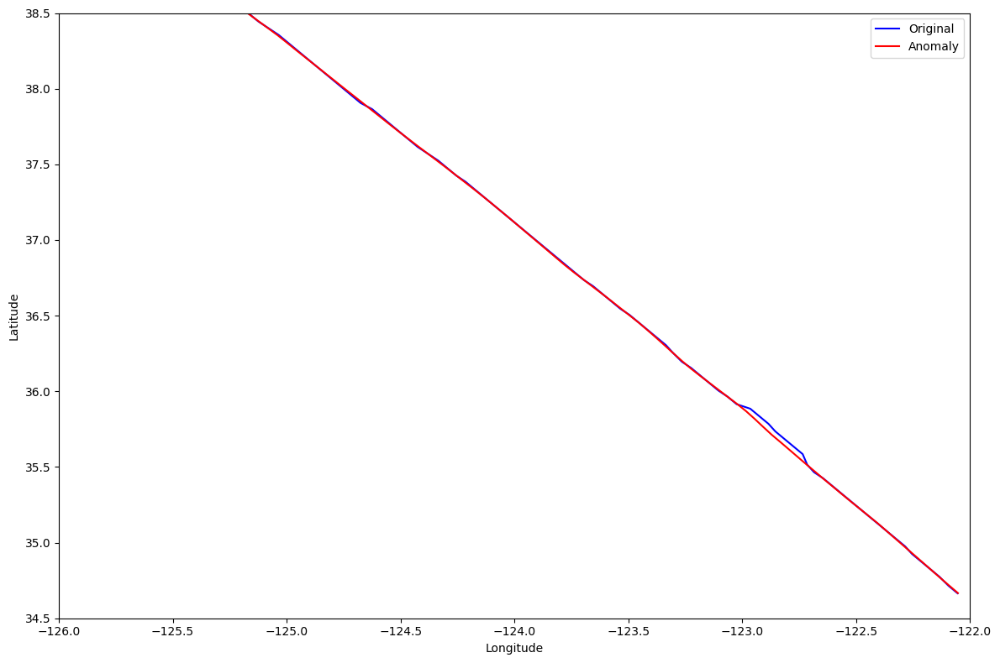

In [74]:
plot_anomaly(atrj, train[2219]['traj'], 2219, save_dir='anomaly-plots/type1/')

In [23]:
type1_anomalies = inject_type1_deviate(
    train,
    share_anomalous_trjs=0.3,   # Number of trajectories that are anomalied in the input set
    magnitude_grids=2,          # Number of grid cells the trajectory is shifted
    share_anomalous_points=0.1, # Number of points in the trajectory that are shifted
    lat_grid_num=400,
    lon_grid_num=400
)

## Plot

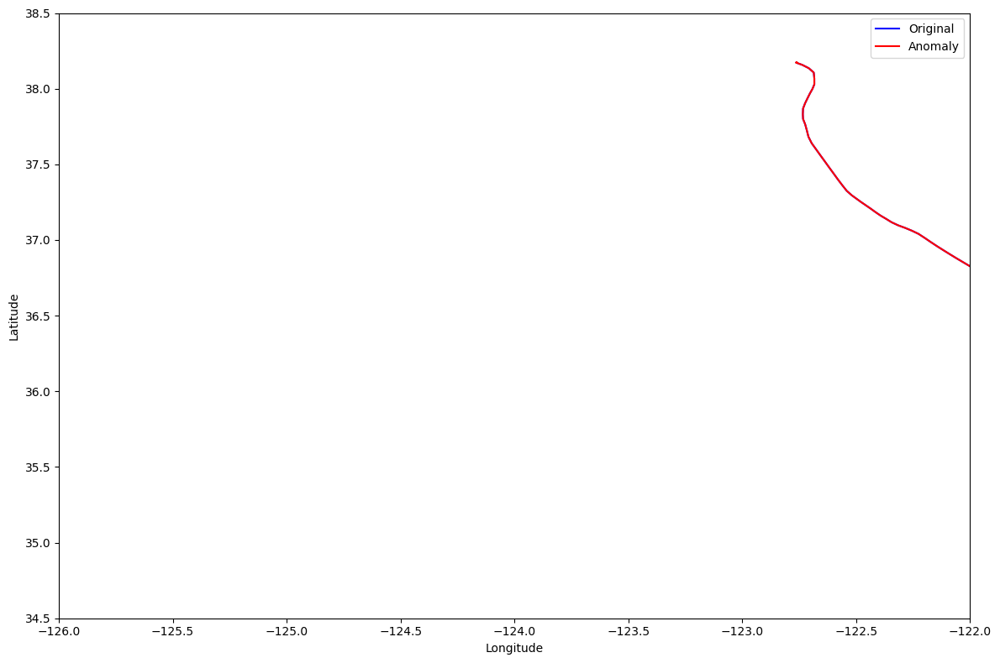

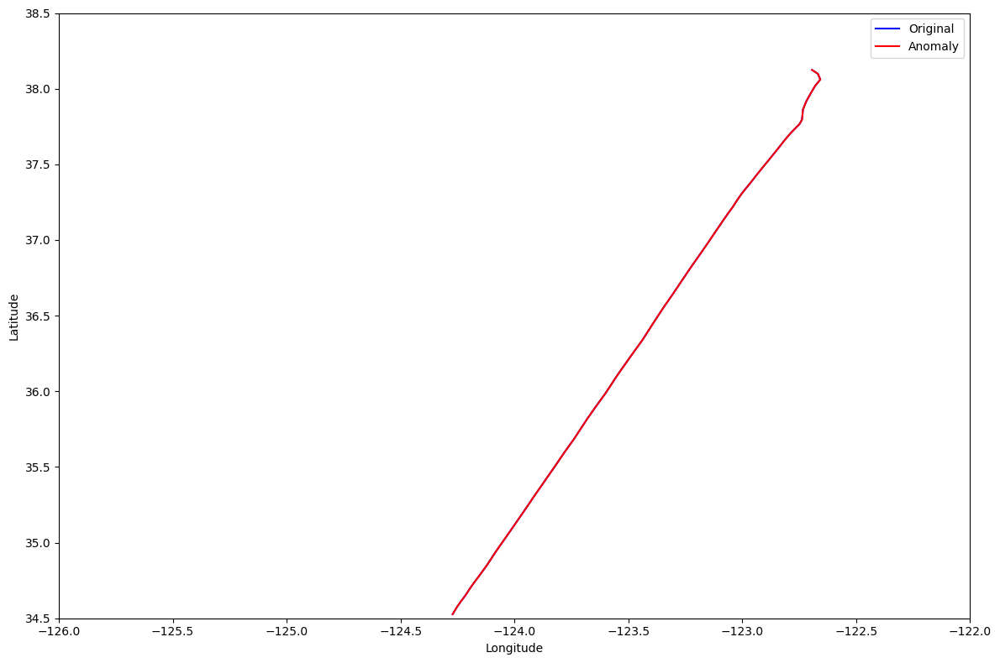

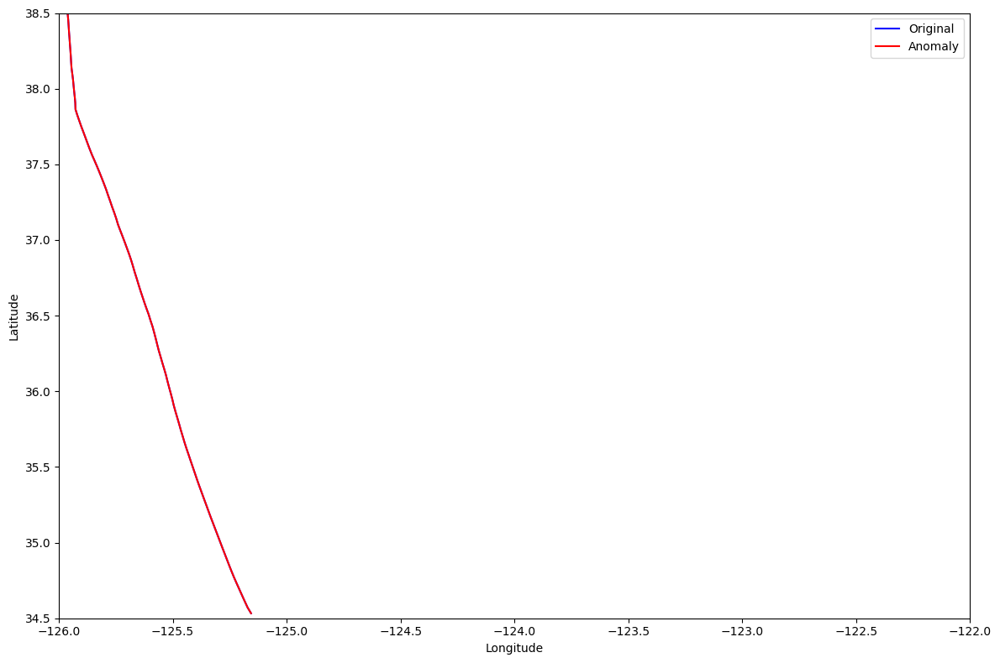

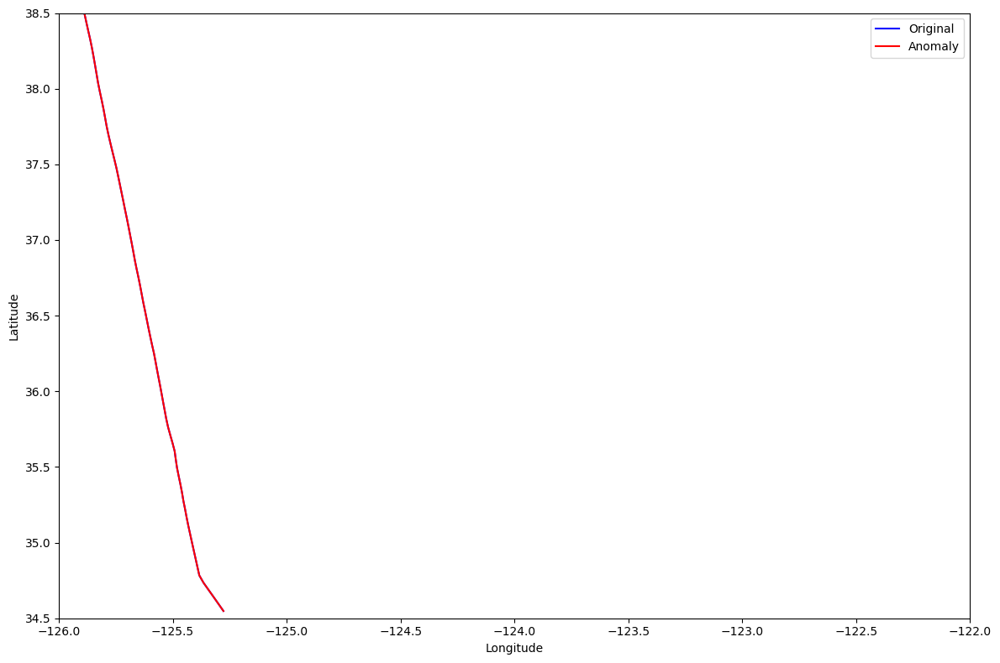

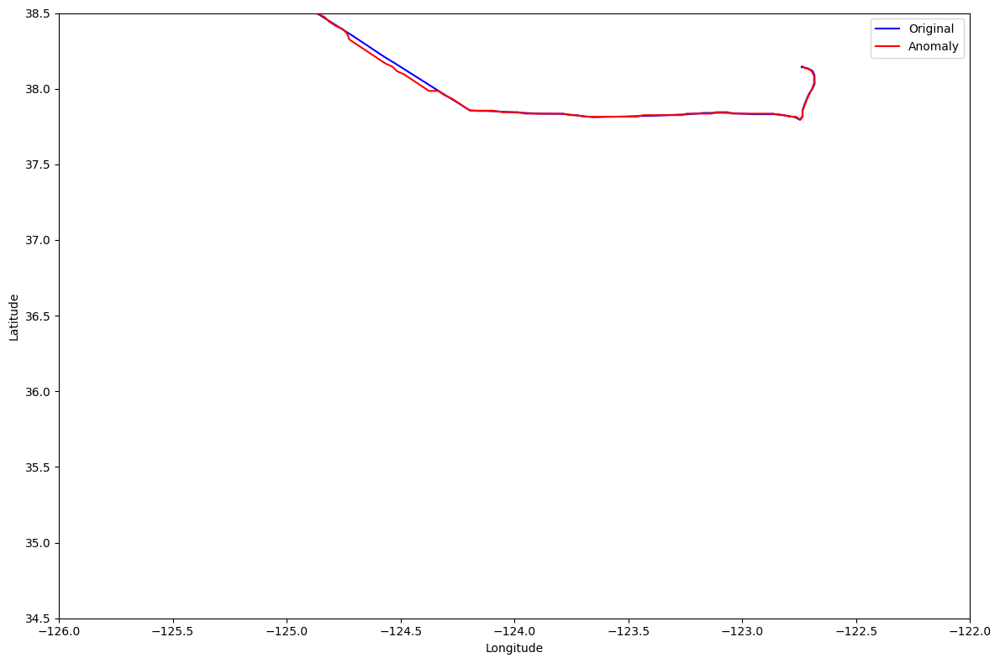

...

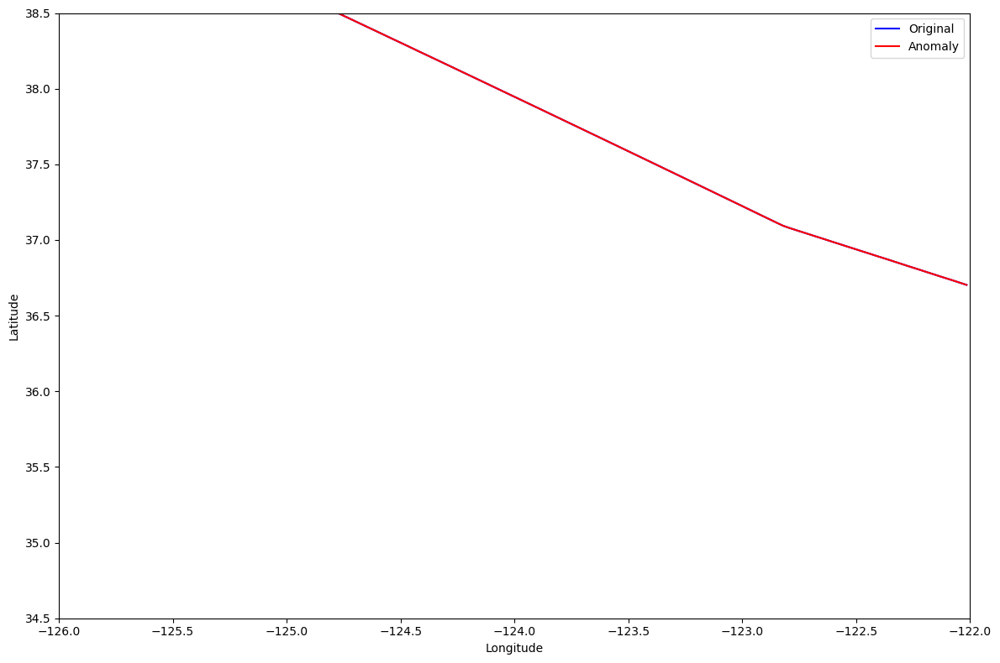

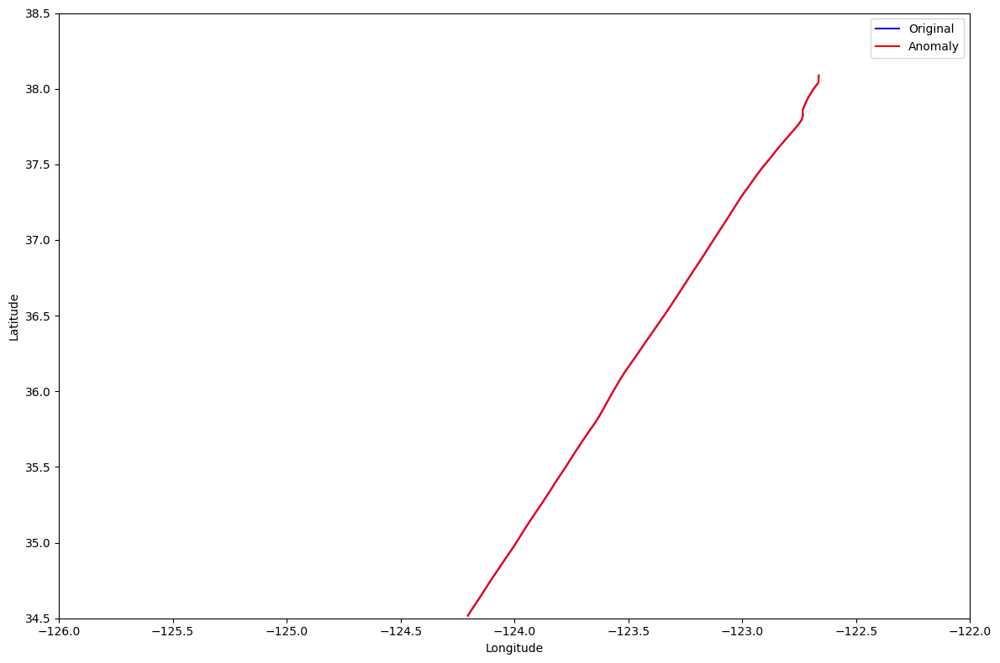

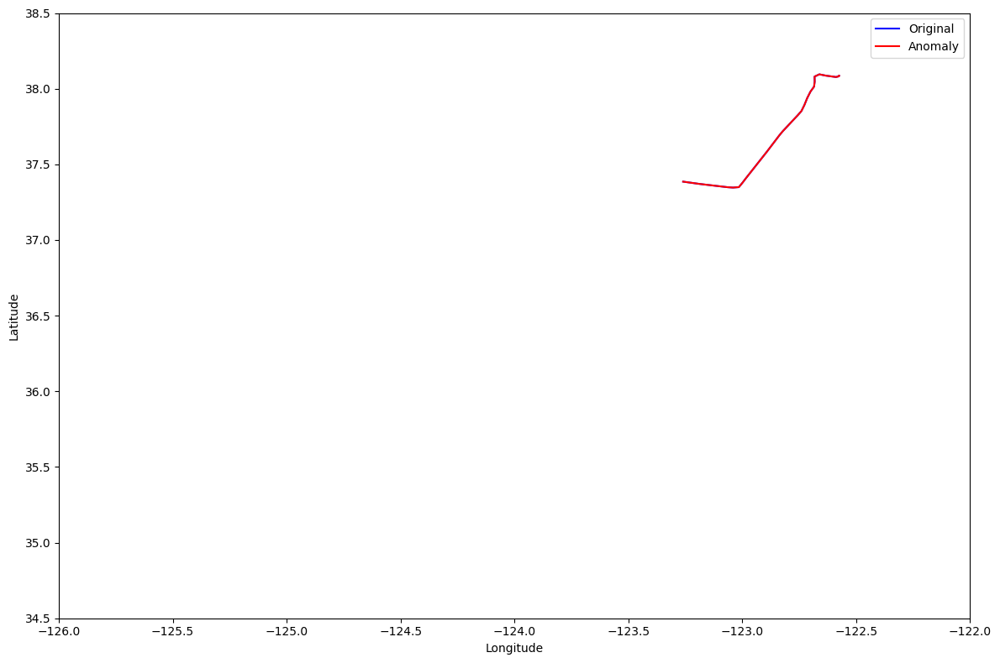

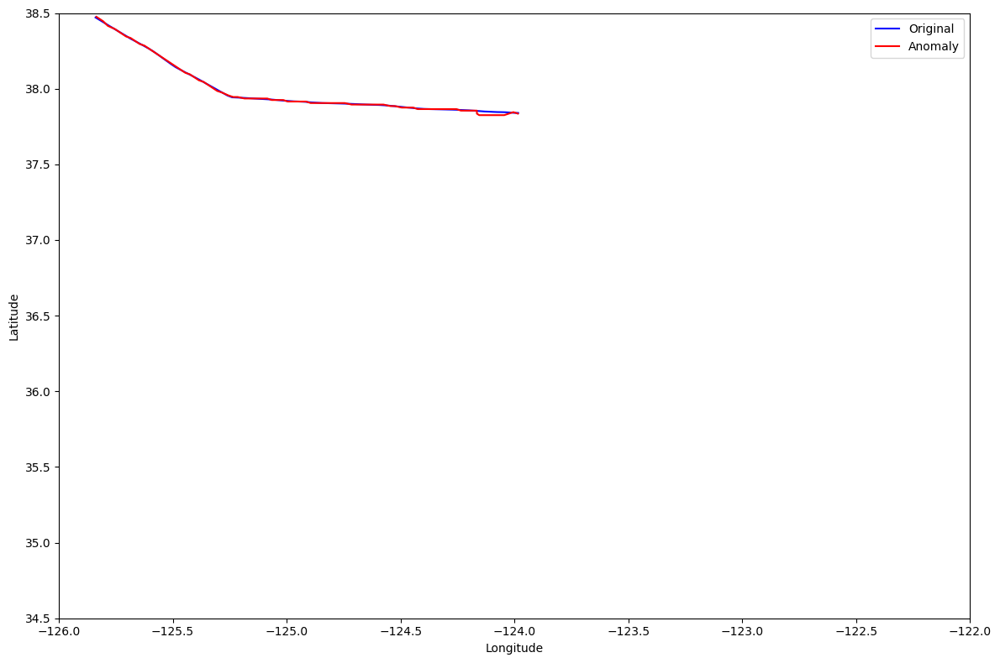

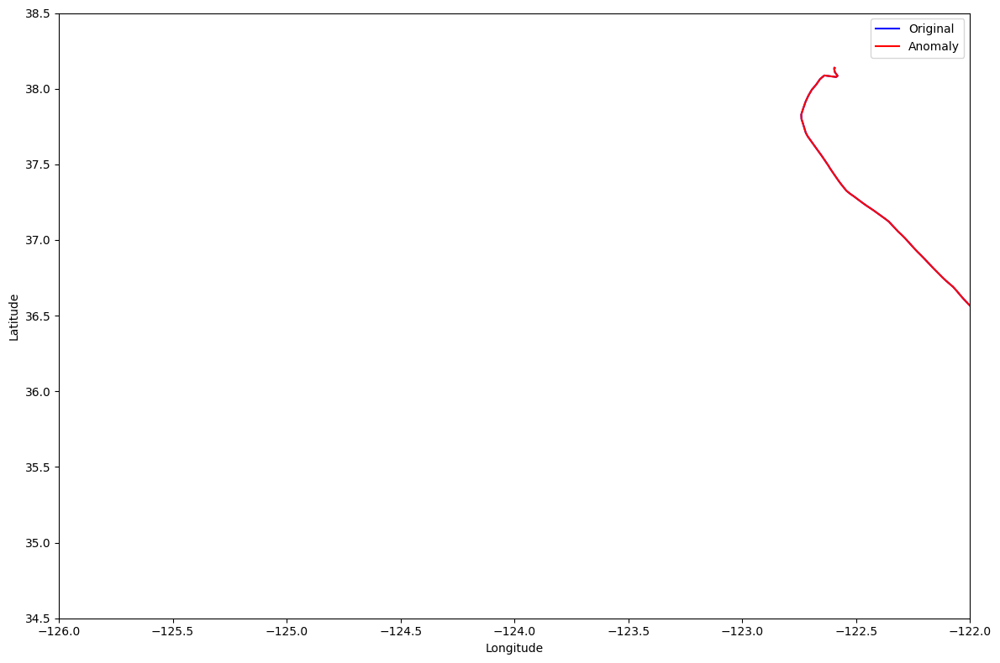

In [29]:
plot_anomalies(500, type1_anomalies, save_dir='anomaly-plots/type1/', dpi=300)

# Type 2 Abnormal Heading

In [76]:
def permute_trajectory_type_2(trajectory,
                              share_anomalous_points,
                              n_waves,
                              magnitude):

        trajectory = copy.deepcopy(trajectory)


        # Select n consecutive points in selected trajectory
        len_trajectory = trajectory.shape[0]
        n_anomalous_points = int(share_anomalous_points * len_trajectory)
        st_anom_idx = np.random.randint(0, len_trajectory - n_anomalous_points - 1)
        ed_anom_idx = st_anom_idx + n_anomalous_points

        phase = np.linspace(0, n_waves*np.pi, n_anomalous_points)

        magnitude_scaler_lat = np.sin(np.linspace(0.2, 1, n_anomalous_points) * np.pi)
        magnitude_scaler_lon = np.cos(np.linspace(0.2, 1, n_anomalous_points) * np.pi)

        magnitude_lat = trajectory[:, LAT][st_anom_idx:ed_anom_idx].mean() * magnitude * magnitude_scaler_lat
        magnitude_lon = trajectory[:, LON][st_anom_idx:ed_anom_idx].mean() * magnitude * magnitude_scaler_lon

        deviation_lat = magnitude_lat * np.sin(phase)
        deviation_lon = magnitude_lon * np.cos(phase)

        trajectory[:, LAT][st_anom_idx:ed_anom_idx] += deviation_lat
        trajectory[:, LON][st_anom_idx:ed_anom_idx] += deviation_lon

        # Add noise to COG attribute
        noise = np.random.normal(loc=0, scale=10, size=n_anomalous_points) # 10 degrees deviations like used in the publication
        trajectory[:, COG][st_anom_idx:ed_anom_idx] = np.clip(trajectory[:, COG][st_anom_idx:ed_anom_idx] + noise, 0, 359)

        return trajectory

In [50]:
def inject_type2_heading(original_trajectories,
                         share_anomalous_trjs,
                         share_anomalous_points,
                         magnitude,
                         n_waves):

    trajectories = copy.deepcopy(original_trajectories)

    # Select n trajectories to inject anomalies
    n_anomalous_trajectories = int(len(trajectories) * share_anomalous_trjs)
    trajectories_idx = np.arange(0, len(trajectories))
    traj_anom_idx = np.random.choice(trajectories_idx, n_anomalous_trajectories, replace=False)

    for idx in traj_anom_idx:
        # Retrieve trajectory as variable
        trajectory = trajectories[idx]['traj']

        # Insert permutations
        trajectory = permute_trajectory_type_2(trajectory, share_anomalous_points, n_waves, magnitude)

        # Add replace original trajectory with the permuted trajectory
        trajectories[idx]['traj'] = trajectory

    return trajectories, traj_anom_idx

## Generate

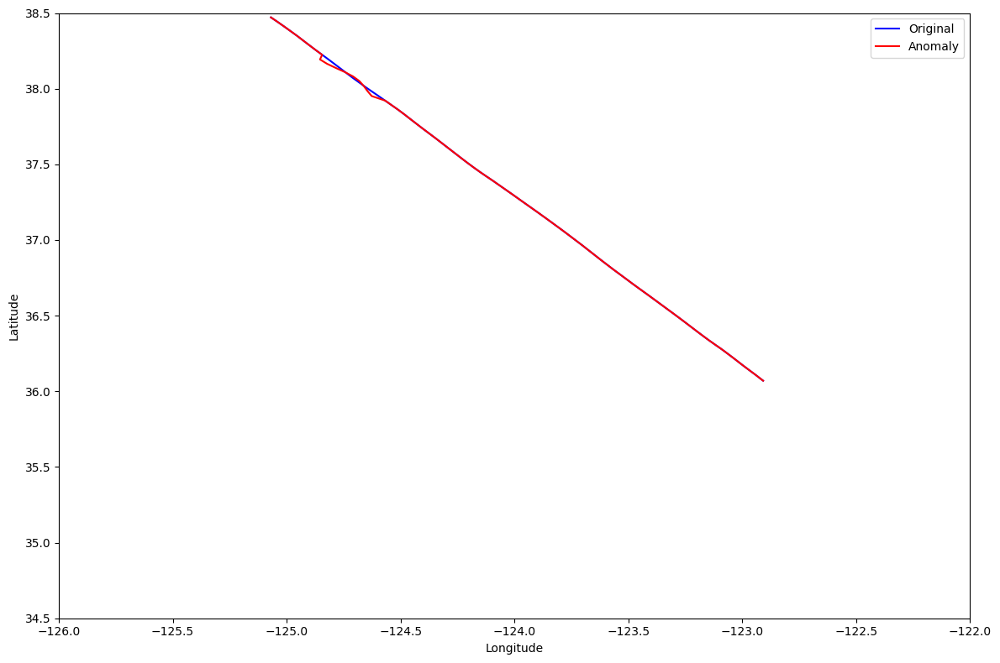

In [82]:
i = 7
trajectory = train[i]['traj']
anomaly = permute_trajectory_type_2(trajectory,
                                    share_anomalous_points=0.1,
                                    n_waves=1,
                                    magnitude=0.0003)

plot_anomaly(trajectory, anomaly, i, save_dir='anomaly-plots/type2/')

In [113]:
type2_anomalies = inject_type2_heading(
    train,
    share_anomalous_trjs=0.3,
    share_anomalous_points=0.05,
    magnitude=0.0005,
    n_waves=1,
)

In [114]:
anom_idx = set(type2_anomalies[1])
all_idx = set(list(range(0, len(train))))
clean_idx = all_idx.difference(anom_idx)

In [115]:
i = type2_anomalies[1][0]
i

np.int64(161)

In [116]:
original = train[i]['traj'][:, COG]

In [117]:
anomalied = type2_anomalies[0][i]['traj'][:, COG]

In [118]:
original - anomalied

array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00, -1.41335946e+01,
        1.76440004e+01, -1.28763702e-02,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  

## Plot

### COG

In [119]:
def plot_cog_anomalies(n_plots, anomalies):
    idx = np.random.choice(np.array(list(anom_idx)), size=n_plots)

    for i in idx:
        old_sog = train[i]['traj'][:, COG]
        old_time = train[i]['traj'][:, TS]

        new_sog = anomalies[0][i]['traj'][:, COG]
        new_time = anomalies[0][i]['traj'][:, TS]

        fig, ax = plt.subplots(figsize=(12, 8))
        ax.plot(old_time, old_sog, 'b', label='Original')
        ax.plot(new_time, new_sog, 'r', label='Anomalied')
        plt.title(f'Artificial Anomaly for idx {i}')
        plt.ylabel('COG')
        plt.xlabel('timestamp')
        plt.ylim(0, 365)
        plt.legend()
        plt.show()

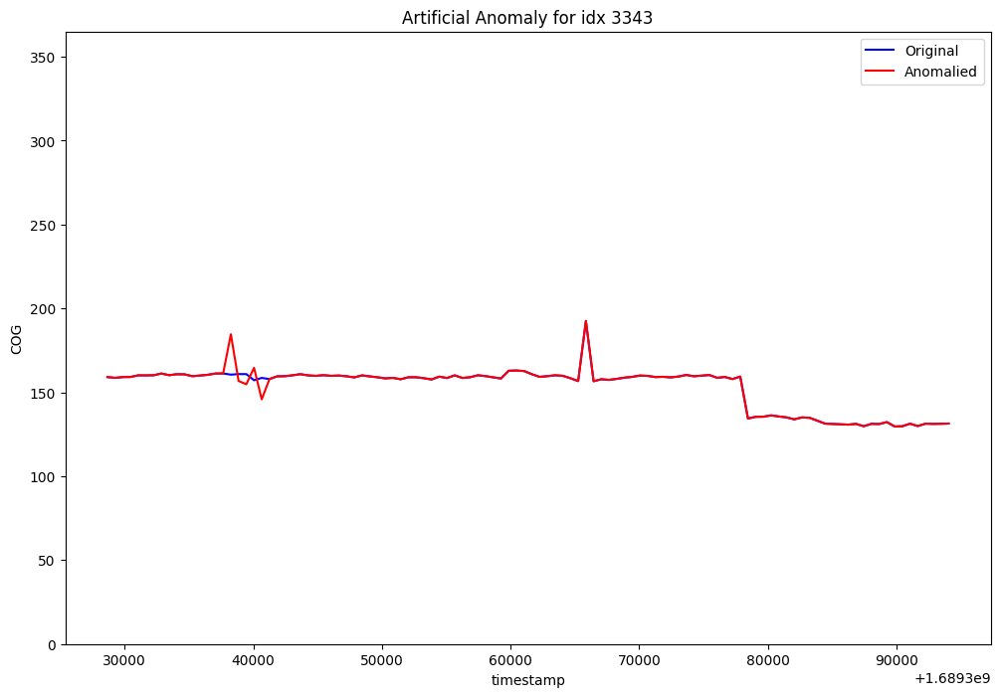

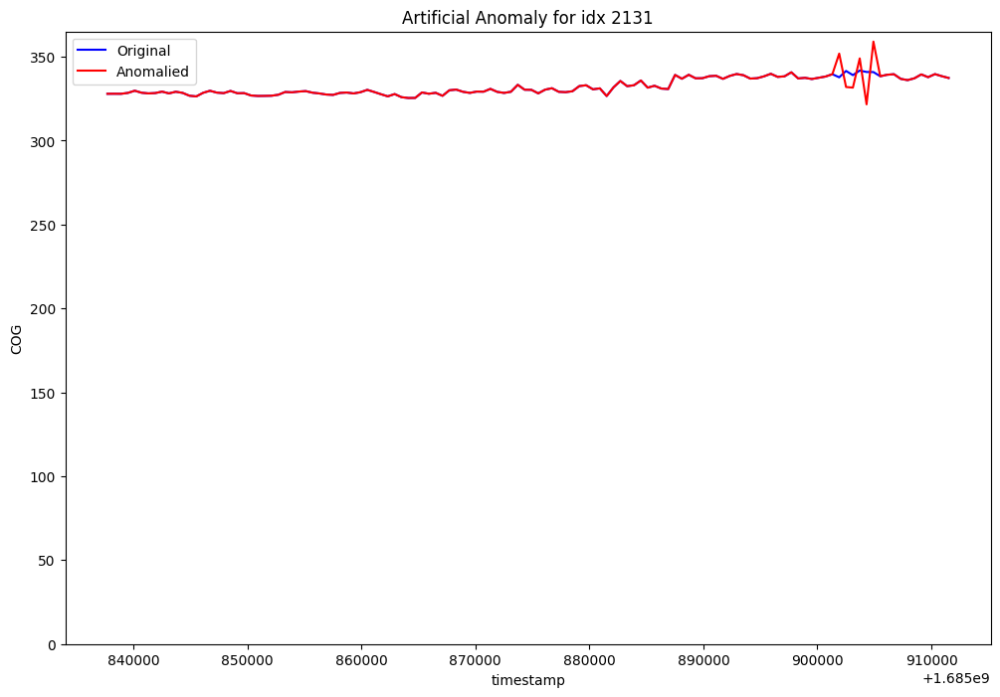

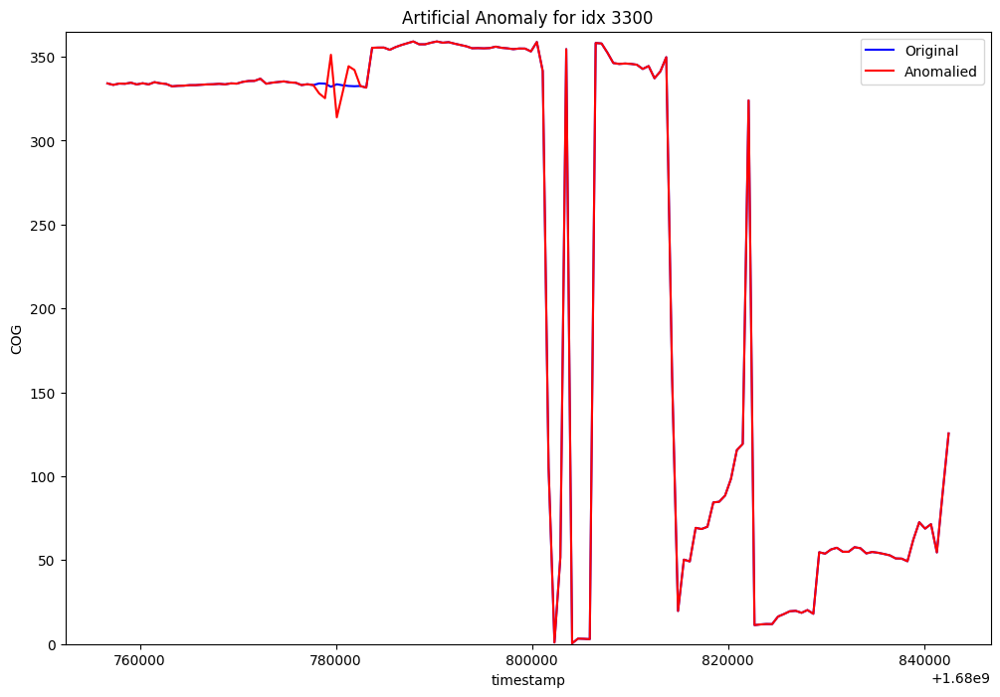

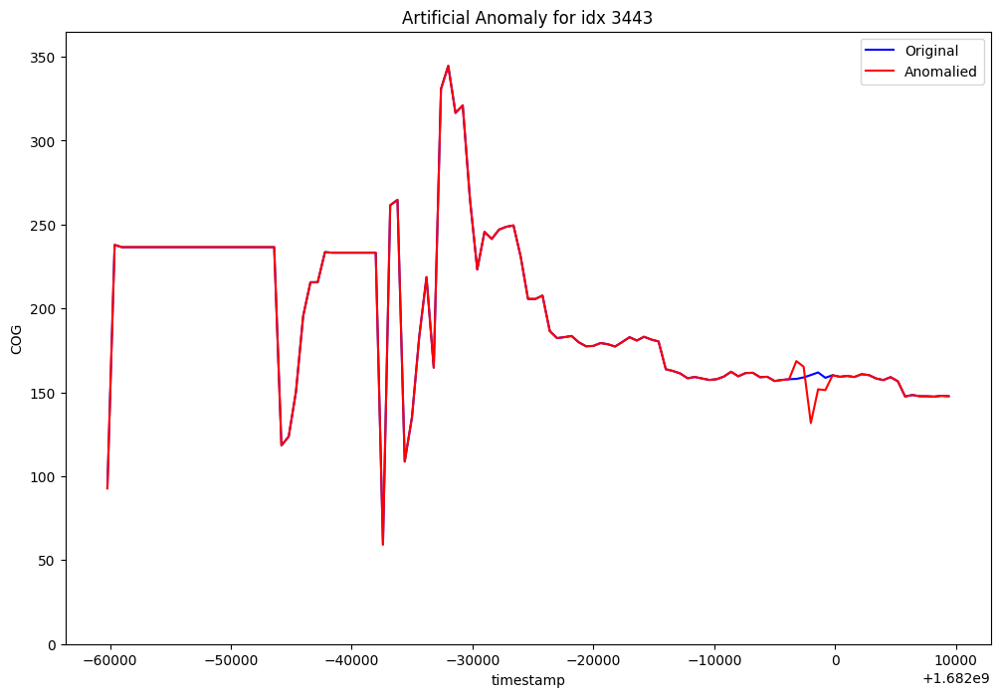

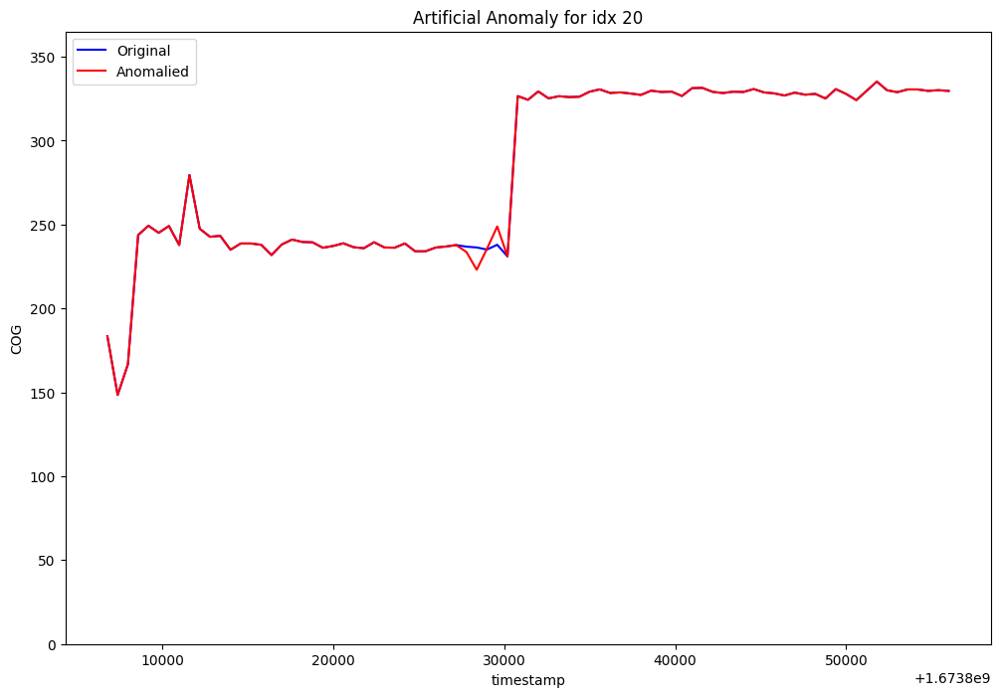

In [120]:
plot_cog_anomalies(5, type2_anomalies)

### Position plots

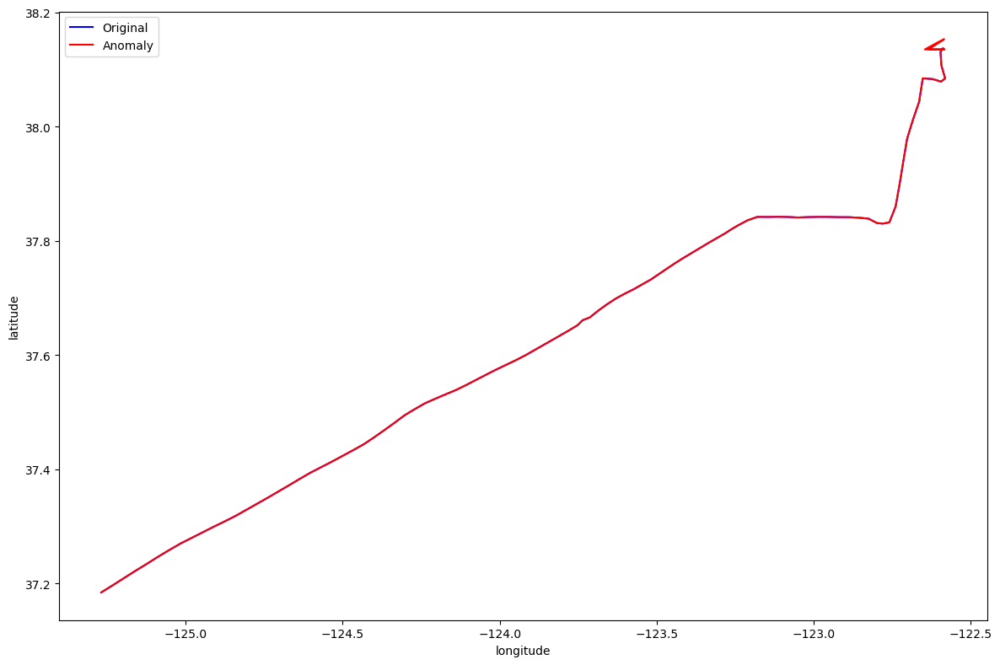

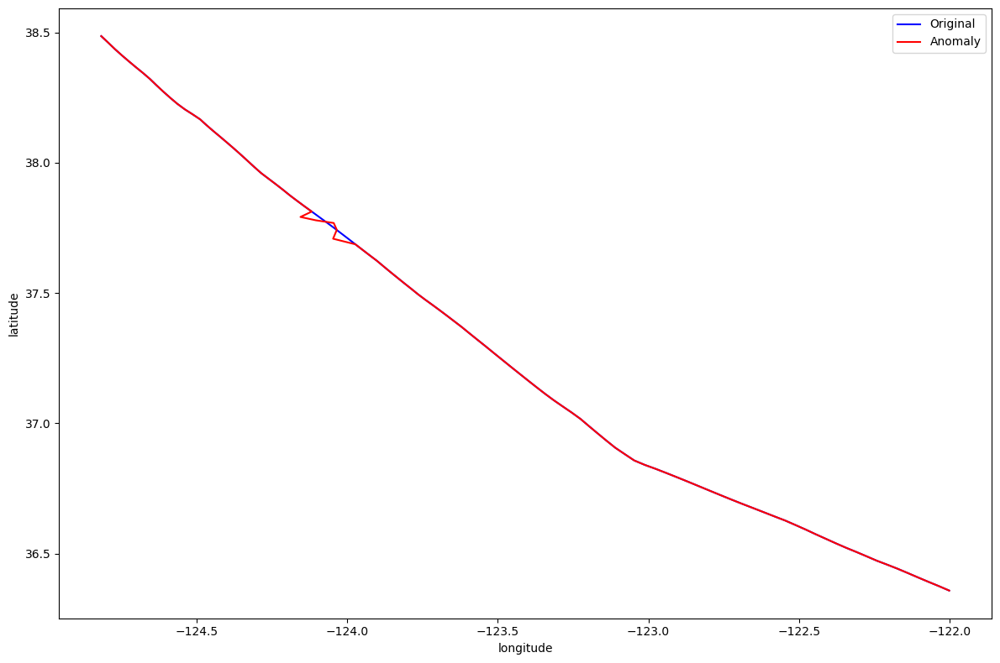

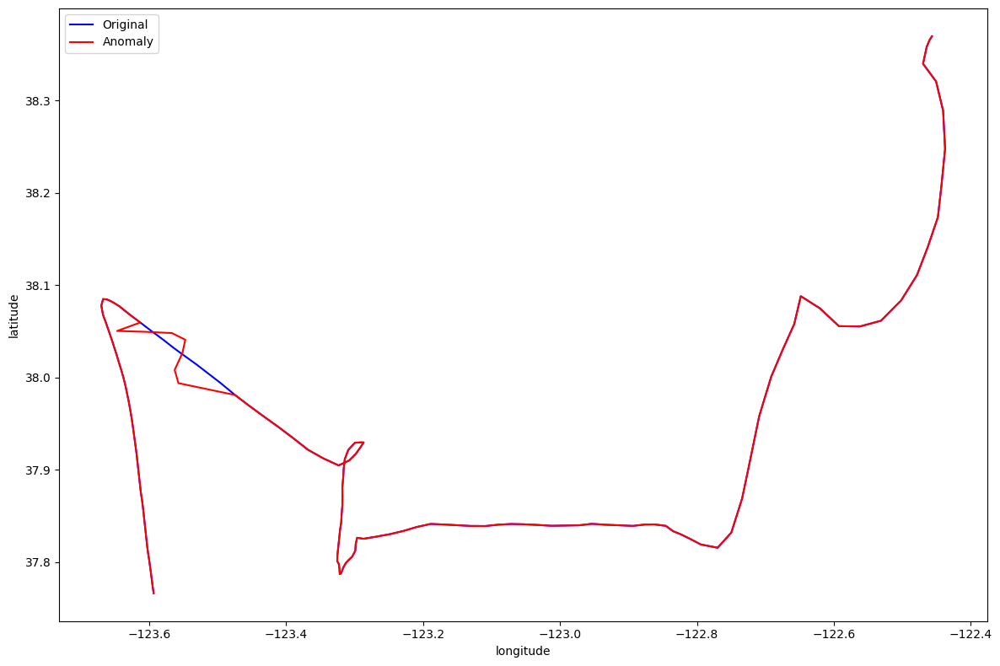

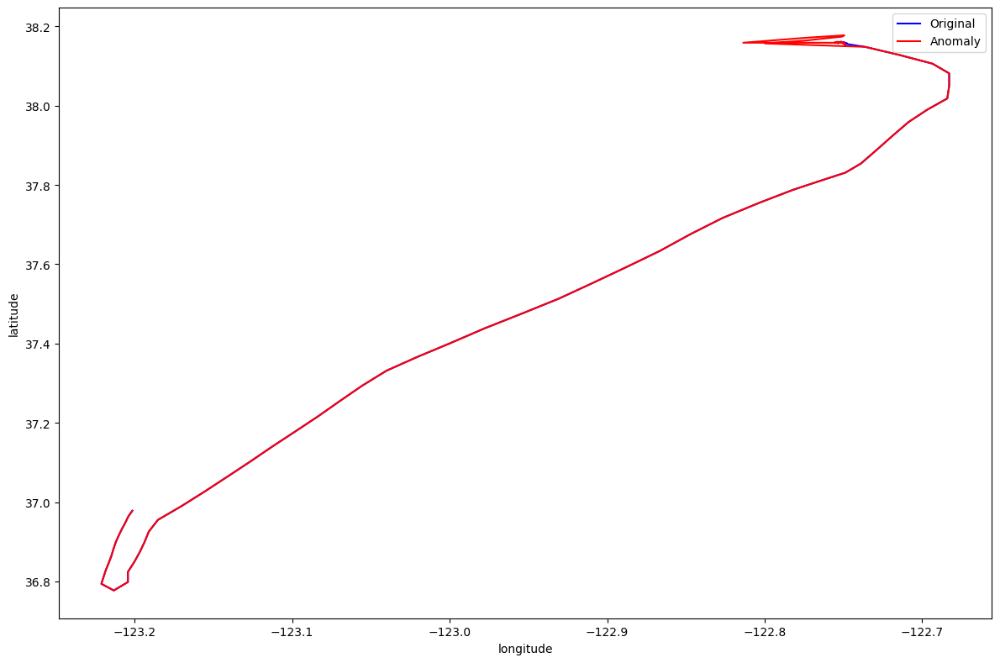

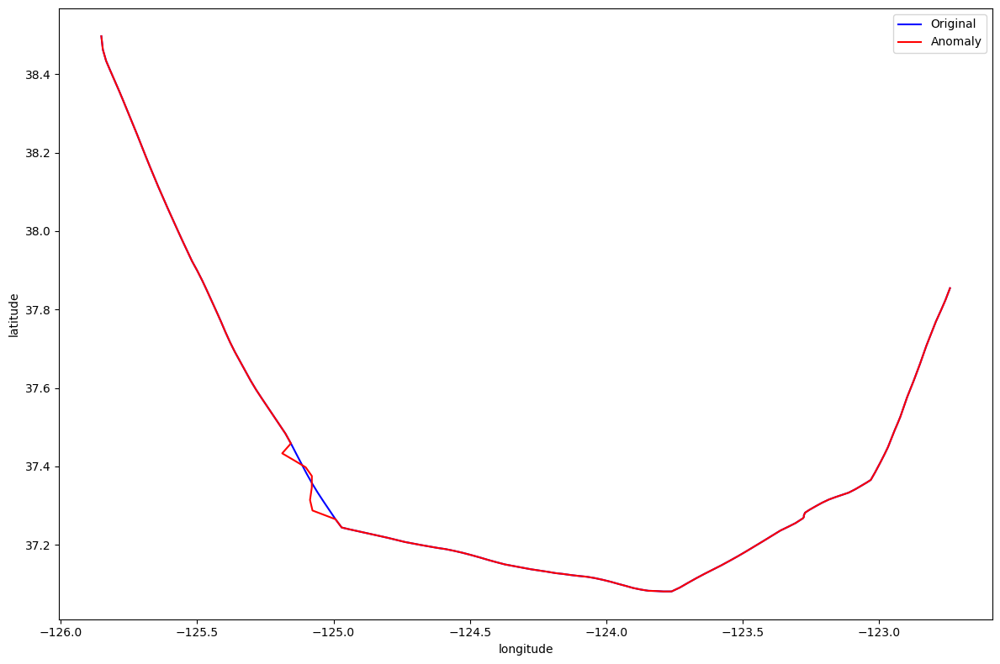

...

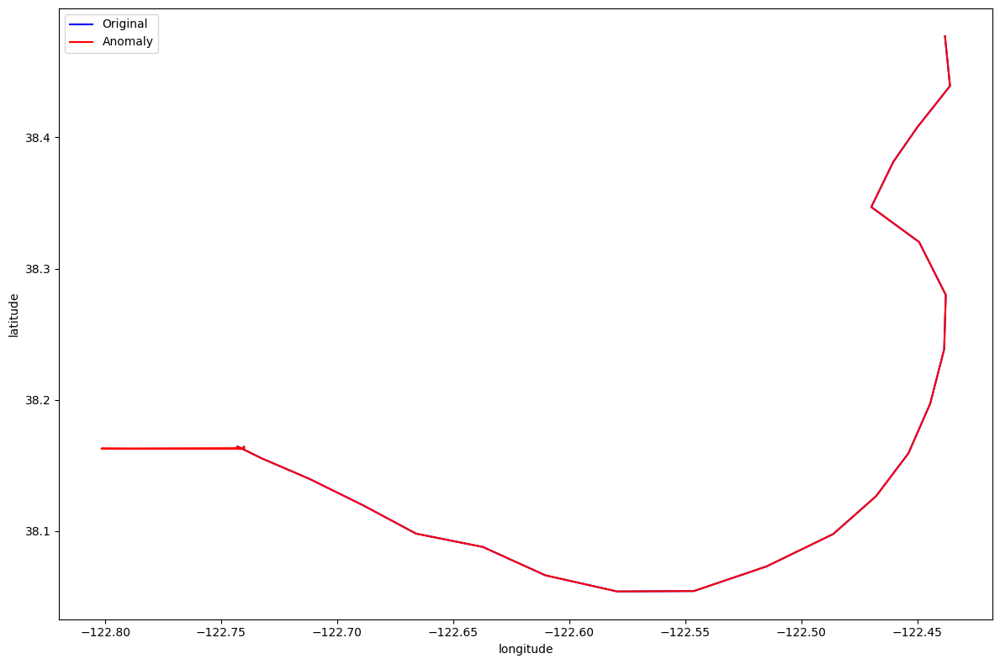

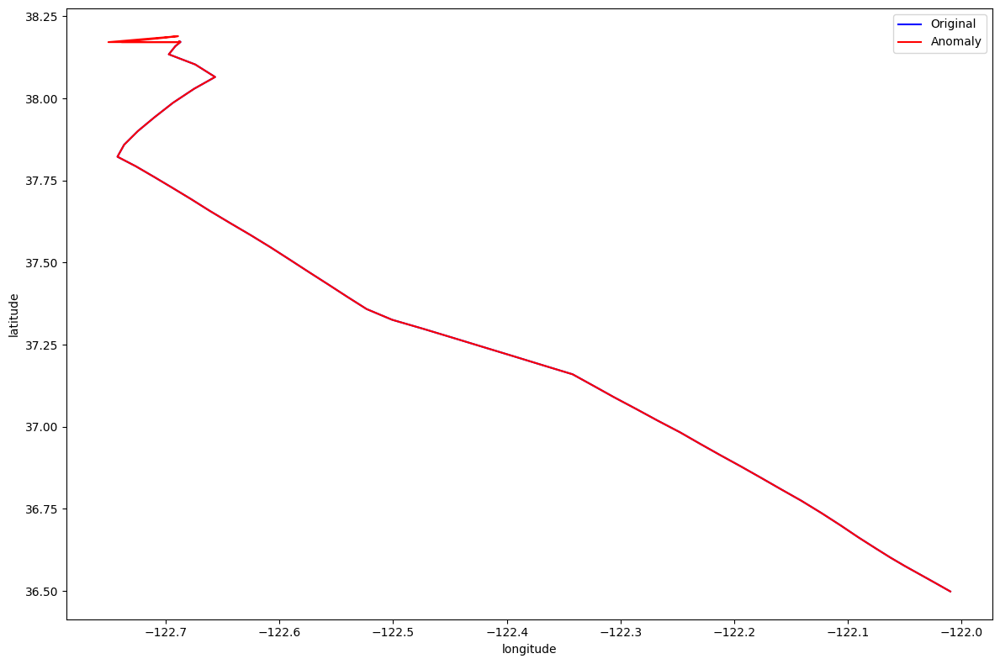

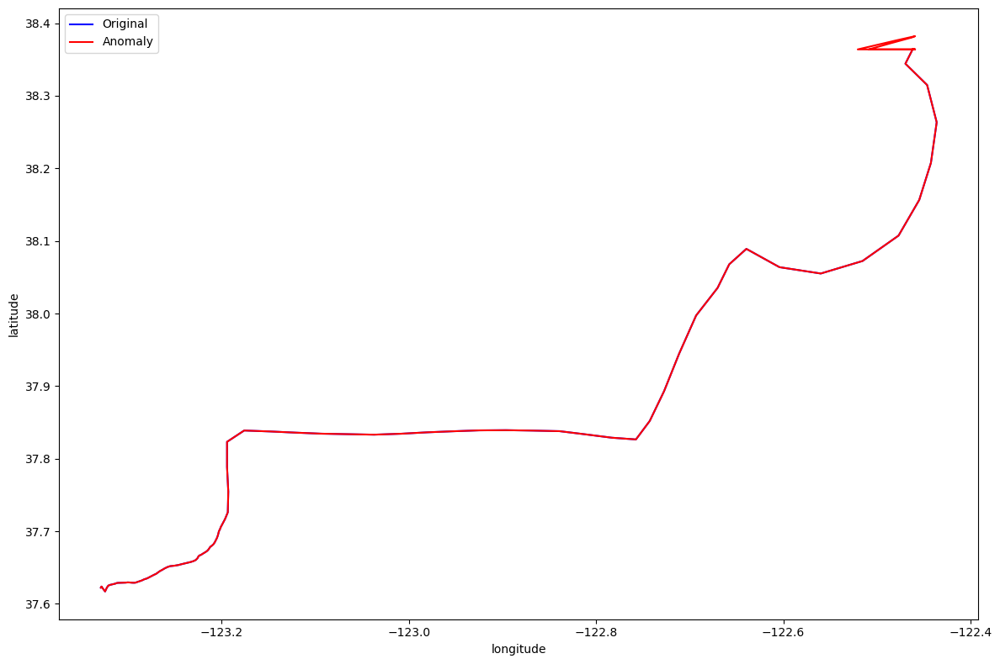

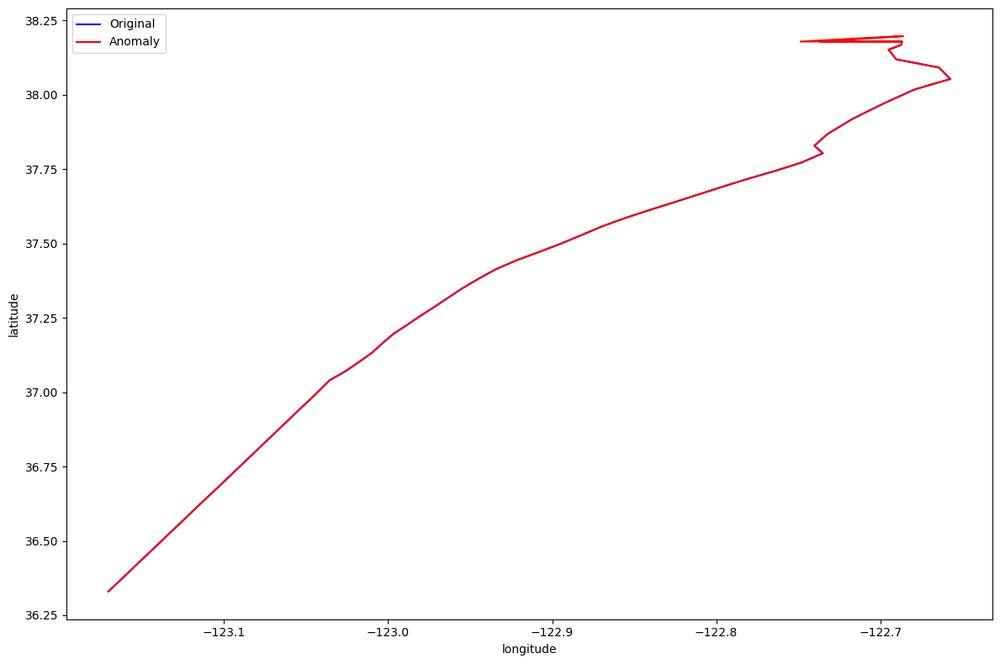

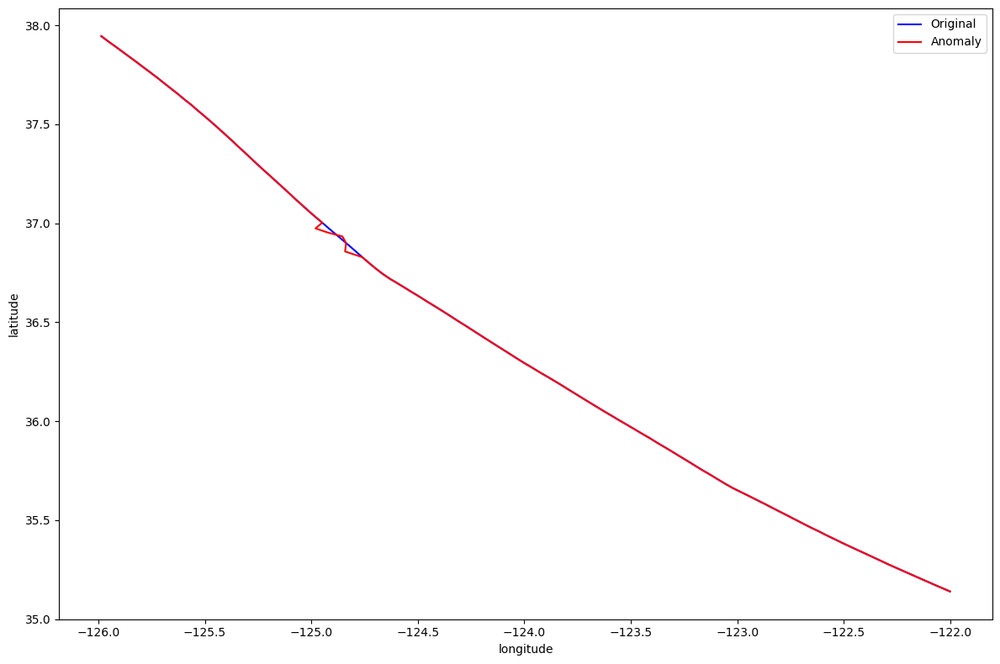

In [ ]:
plot_anomalies(30, type2_anomalies,
               save_dir='anomaly-plots/type2',
               dpi=1000)

# Type 3 Sudden change of Speed

In [ ]:
def create_abnormal_speeding(trajectory, share_anomalous_points):

    trajectory = trajectory.copy()
    len_trajectory = trajectory.shape[0]

    # Select n consecutive points in selected trajectory
    n_anomalous_points = int(share_anomalous_points * len_trajectory)
    st_anom_idx = np.random.randint(0, len_trajectory - n_anomalous_points - 1)
    ed_anom_idx = st_anom_idx + n_anomalous_points

    # Add noise to SOG attribute
    noise = np.random.normal(loc=0, scale=3, size=n_anomalous_points) # 3 knots of speeds deviations like in the publication
    trajectory[:, SOG][st_anom_idx:ed_anom_idx] = np.clip(trajectory[:, SOG][st_anom_idx:ed_anom_idx] + noise, 0, 30)

    return trajectory

In [85]:
def inject_type3_speed(original_trajectories,
                         share_anomalous_trjs,
                         share_anomalous_points):

    trajectories = copy.deepcopy(original_trajectories)

    # Select n trajectories to inject anomalies
    n_anomalous_trajectories = int(len(trajectories) * share_anomalous_trjs)
    trajectories_idx = np.arange(0, len(trajectories))
    traj_anom_idx = np.random.choice(trajectories_idx, n_anomalous_trajectories, replace=False)

    for idx in traj_anom_idx:
        trajectory = trajectories[idx]['traj']
        trajectory = create_abnormal_speeding(trajectory, share_anomalous_points)

        # Replace the original trajectory with the anomalous trajectory
        trajectories[idx]['traj'] = trajectory

    return trajectories, traj_anom_idx

In [ ]:
def plot_speed(original, anomaly, i, save_dir=None):

    old_sog = original[:, SOG]
    old_time = original[:, TS]

    new_sog = anomaly[:, SOG]
    new_time = anomaly[:, TS]

    fig, ax = plt.subplots(figsize=(12, 8))
    ax.plot(old_time, old_sog, 'b', label='Original')
    ax.plot(old_time, new_sog, 'r', label='Anomaly')
    plt.title(f'Artificial Anomaly for idx {i}')
    plt.ylabel('SOG')
    plt.xlabel('timestamp')
    plt.ylim(0, 30)
    plt.legend()
    if save_dir:
        out = os.path.join(save_dir, f'{i}.pdf')
        plt.savefig(out)
    plt.show()

In [105]:
i = 1
original = train[i]['traj']
anomaly = create_abnormal_speeding(trajectory, share_anomalous_points=0.1)
original[:, TS].shape
# plot_speed(original, anomaly, i, save_dir=None)

(77,)

In [104]:
anomaly[:, TS].shape

(90,)

ValueError: x and y must have same first dimension, but have shapes (77,) and (90,)

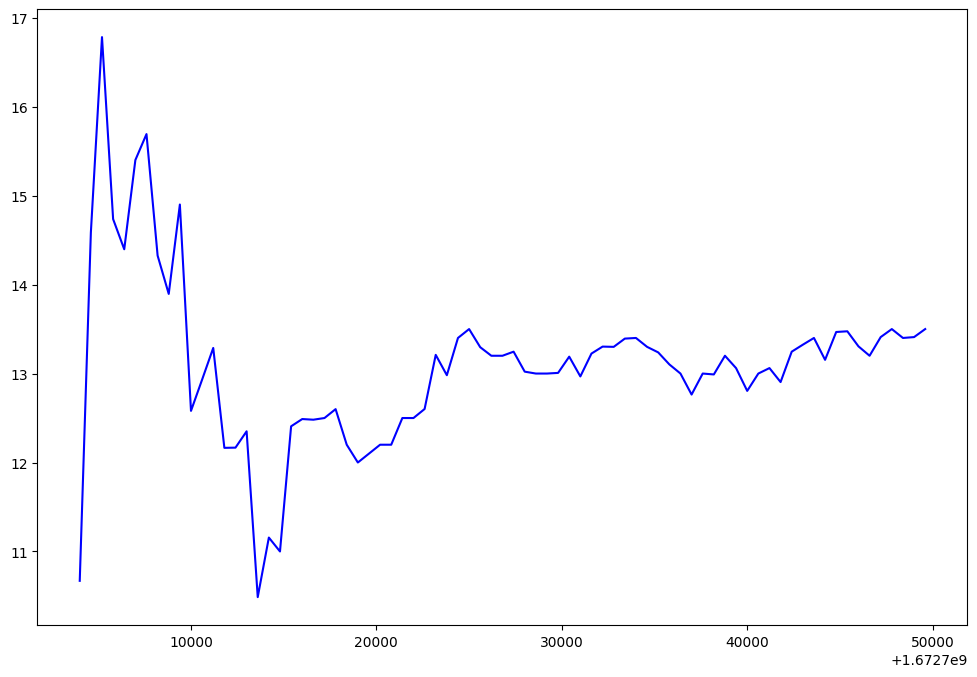

In [103]:
plot_speed(original, anomaly, i, save_dir=None)

In [ ]:
type3_anomalies, type3_anomalies_idx = inject_type3_speed(
    train,
    share_anomalous_trjs=0.2,
    share_anomalous_points=0.2
)

## Plot SOG for the anomalies

In [ ]:
def plot_sog_anomalies(n_plots, anomalies):
    idx = np.random.choice(type3_anomalies_idx, size=n_plots)

    for i in idx:
        old_sog = train[i]['traj'][:, SOG]
        old_time = train[i]['traj'][:, TS]

        new_sog = anomalies[i]['traj'][:, SOG]
        new_time = anomalies[i]['traj'][:, TS]

        fig, ax = plt.subplots(figsize=(12, 8))
        ax.plot(old_time, old_sog, 'b', label='Original')
        ax.plot(new_time, new_sog, 'r', label='Anomalied')
        plt.title(f'Artificial Anomaly for idx {i}')
        plt.ylabel('SOG')
        plt.xlabel('timestamp')
        plt.ylim(0, 30)
        plt.legend()
        plt.show()

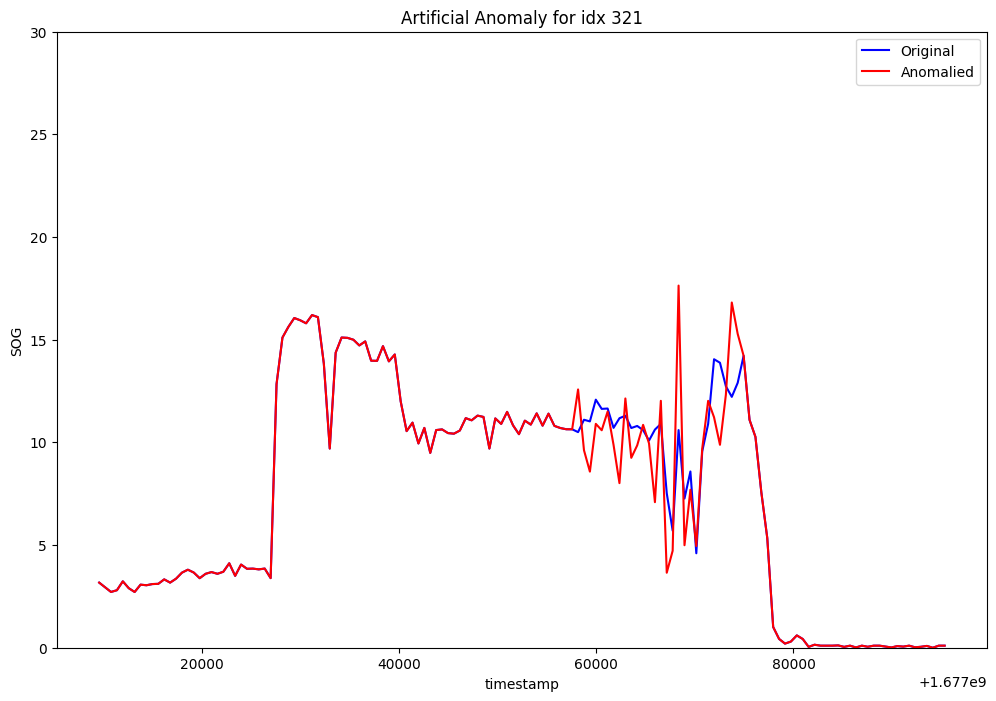

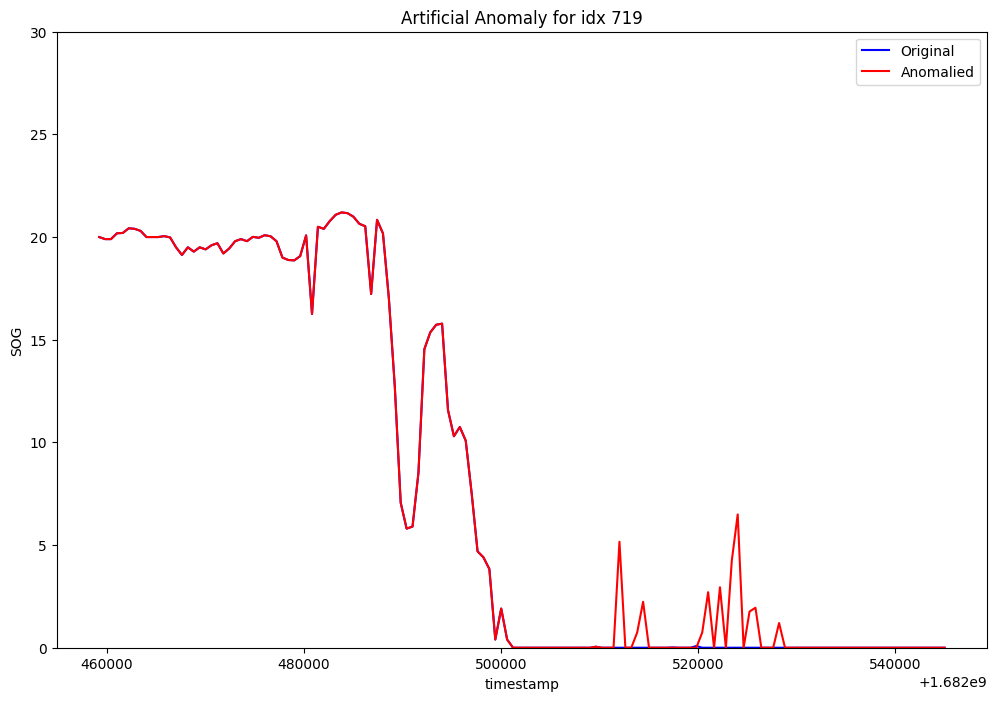

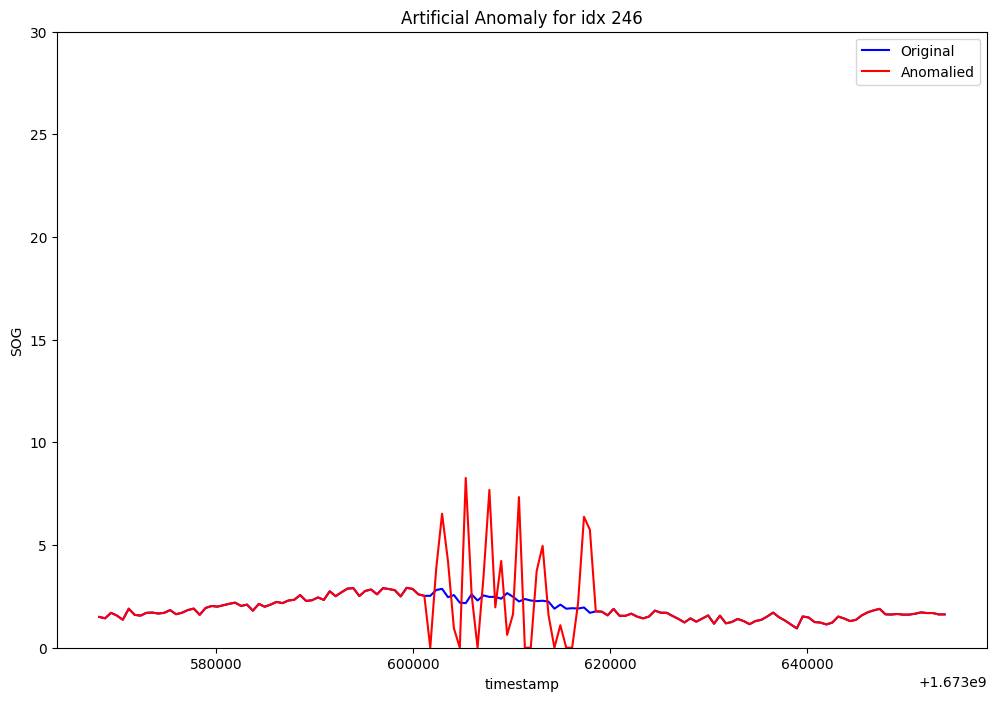

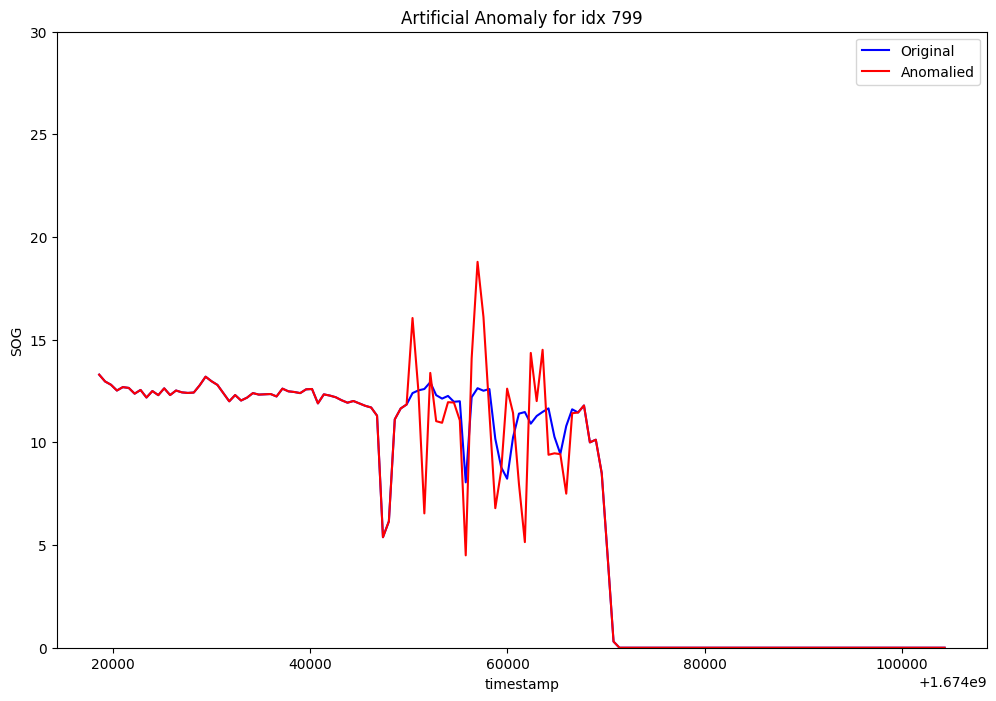

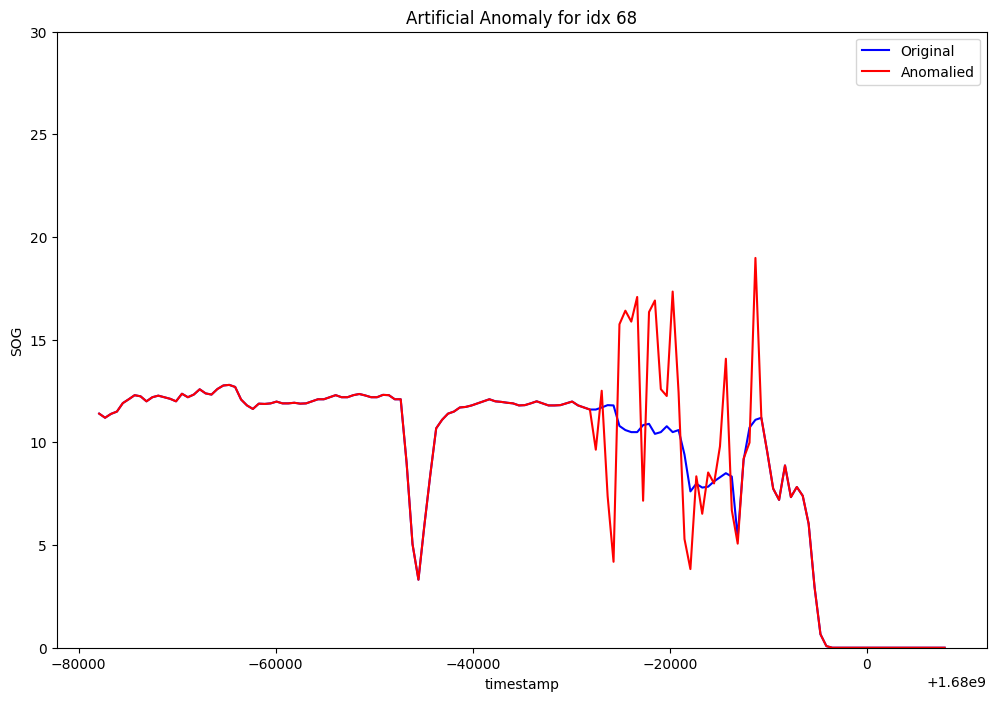

In [ ]:
plot_sog_anomalies(5, type3_anomalies)

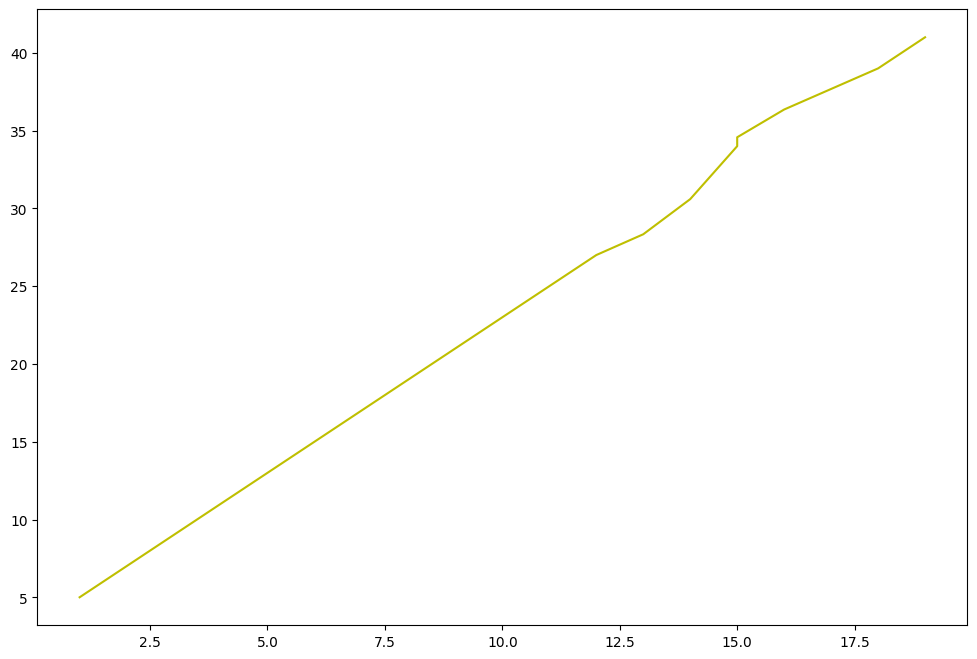

In [ ]:
# Some code for learning how to add sine waves to a trajectory

fig, ax = plt.subplots(figsize=(12, 8))

x = np.arange(1, 20)

y = [2*v+3 for v in x]

z = [np.sin(vy) + vy for vy in y]

g = copy.deepcopy(y)
n_points = int(len(x) * 0.3)
random_start = np.random.randint(0, len(x) - n_points - 1)
random_end = random_start + n_points
a = g[random_start:random_end]
a = [np.sin(va) + va for va in a]
g[random_start:random_end] = a

for i in range(random_start, random_end):
    x[i] = np.sin(x[i]) + x[i]

ax.plot(x, g, 'y')

plt.show()